In [1]:
import urllib
import bz2
import os
import numpy as np

In [2]:
BASE_URL = "http://grail.cs.washington.edu/projects/bal/data/ladybug/"
FILE_NAME = "problem-1031-110968-pre.txt.bz2"
URL = BASE_URL + FILE_NAME

In [3]:
if not os.path.isfile(FILE_NAME):
    urllib.request.urlretrieve(URL, FILE_NAME)

In [4]:
def read_bal_data(file_name):
    with bz2.open(file_name, "rt") as file:
        n_cameras, n_points, n_observations = map(
            int, file.readline().split())

        camera_indices = np.empty(n_observations, dtype=int)
        point_indices = np.empty(n_observations, dtype=int)
        points_2d = np.empty((n_observations, 2))

        for i in range(n_observations):
            camera_index, point_index, x, y = file.readline().split()
            camera_indices[i] = int(camera_index)
            point_indices[i] = int(point_index)
            points_2d[i] = [float(x), float(y)]

        camera_params = np.empty(n_cameras * 9)
        for i in range(n_cameras * 9):
            camera_params[i] = float(file.readline())
        camera_params = camera_params.reshape((n_cameras, -1))

        points_3d = np.empty(n_points * 3)
        for i in range(n_points * 3):
            points_3d[i] = float(file.readline())
        points_3d = points_3d.reshape((n_points, -1))

    return camera_params, points_3d, camera_indices, point_indices, points_2d

In [5]:
camera_params, points_3d, camera_indices, point_indices, points_2d = read_bal_data(FILE_NAME)

In [6]:
n_cameras = camera_params.shape[0]
n_points = points_3d.shape[0]

n = 9 * n_cameras + 3 * n_points
m = 2 * points_2d.shape[0]

print("n_cameras: {}".format(n_cameras))
print("n_points: {}".format(n_points))
print("Total number of parameters: {}".format(n))
print("Total number of residuals: {}".format(m))

n_cameras: 1031
n_points: 110968
Total number of parameters: 342183
Total number of residuals: 1000530


In [7]:
def rotate(points, rot_vecs):
    """Rotate points by given rotation vectors.
    
    Rodrigues' rotation formula is used.
    """
    theta = np.linalg.norm(rot_vecs, axis=1)[:, np.newaxis]
    with np.errstate(invalid='ignore'):
        v = rot_vecs / theta
        v = np.nan_to_num(v)
    dot = np.sum(points * v, axis=1)[:, np.newaxis]
    cos_theta = np.cos(theta)
    sin_theta = np.sin(theta)

    return cos_theta * points + sin_theta * np.cross(v, points) + dot * (1 - cos_theta) * v

In [8]:
def project(points, camera_params):
    """Convert 3-D points to 2-D by projecting onto images."""
    points_proj = rotate(points, camera_params[:, :3])
    points_proj += camera_params[:, 3:6]
    points_proj = -points_proj[:, :2] / points_proj[:, 2, np.newaxis]
    f = camera_params[:, 6]
    k1 = camera_params[:, 7]
    k2 = camera_params[:, 8]
    n = np.sum(points_proj**2, axis=1)
    r = 1 + k1 * n + k2 * n**2
    points_proj *= (r * f)[:, np.newaxis]
    return points_proj

In [9]:
def fun(params, n_cameras, n_points, camera_indices, point_indices, points_2d):
    """Compute residuals.
    
    `params` contains camera parameters and 3-D coordinates.
    """
    camera_params = params[:n_cameras * 9].reshape((n_cameras, 9))
    points_3d = params[n_cameras * 9:].reshape((n_points, 3))
    points_proj = project(points_3d[point_indices], camera_params[camera_indices])
    return (points_proj - points_2d).ravel()

In [10]:
from scipy.sparse import lil_matrix

In [11]:
def bundle_adjustment_sparsity(n_cameras, n_points, camera_indices, point_indices):
    m = camera_indices.size * 2
    n = n_cameras * 9 + n_points * 3
    A = lil_matrix((m, n), dtype=int)

    i = np.arange(camera_indices.size)
    for s in range(9):
        A[2 * i, camera_indices * 9 + s] = 1
        A[2 * i + 1, camera_indices * 9 + s] = 1

    for s in range(3):
        A[2 * i, n_cameras * 9 + point_indices * 3 + s] = 1
        A[2 * i + 1, n_cameras * 9 + point_indices * 3 + s] = 1

    return A

In [12]:
%matplotlib inline
import matplotlib.pyplot as plt

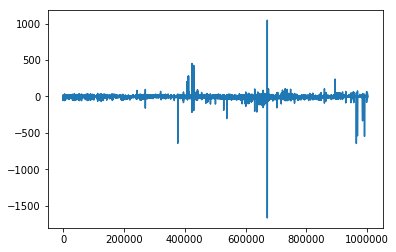

In [13]:
x0 = np.hstack((camera_params.ravel(), points_3d.ravel()))
f0 = fun(x0, n_cameras, n_points, camera_indices, point_indices, points_2d)
plt.plot(f0)

In [14]:
A = bundle_adjustment_sparsity(n_cameras, n_points, camera_indices, point_indices)

In [15]:
import time
from scipy.optimize import least_squares

In [16]:
t0 = time.time()
res = least_squares(fun, x0, jac_sparsity=A, verbose=2, x_scale='jac', ftol=1e-4, method='trf',
                    args=(n_cameras, n_points, camera_indices, point_indices, points_2d))
t1 = time.time()

   Iteration     Total nfev        Cost      Cost reduction    Step norm     Optimality   
       0              1         1.8202e+07                                    2.38e+11    
       1              2         1.8323e+06      1.64e+07       3.27e+02       8.94e+16    
       2              4         7.5653e+05      1.08e+06       4.75e+01       3.33e+12    
       3              5         5.9941e+05      1.57e+05       1.93e+01       1.85e+12    
       4              6         2.8574e+05      3.14e+05       7.64e+00       3.53e+12    
       5              7         2.7713e+05      8.61e+03       1.84e+01       6.58e+12    
       6              9         2.7663e+05      4.93e+02       2.57e+01       2.19e+13    
       7             10         2.7663e+05      8.63e+00       5.47e+01       6.23e+19    
       8             12         2.7649e+05      1.36e+02       4.34e-01       8.88e+14    
       9             13         2.7644e+05      5.21e+01       1.50e-01       1.09e+20    

In [17]:
print("Optimization took {0:.0f} seconds".format(t1 - t0))

Optimization took 634 seconds


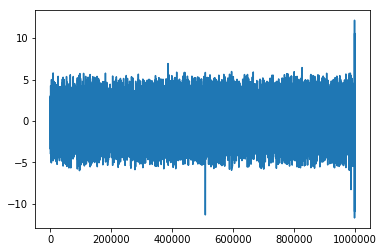

In [18]:
plt.plot(res.fun)

In [19]:
res

 active_mask: array([ 0.,  0.,  0., ...,  0.,  0.,  0.])
        cost: 276369.81689059624
         fun: array([ 0.09113532, -0.1907569 , -0.33572623, ...,  0.08093953,
       -0.01991308, -0.07351793])
        grad: array([ 1.06419203,  0.49603388, -1.62534522, ...,  0.05782363,
        0.20187909,  0.15871724])
         jac: <1000530x342183 sparse matrix of type '<class 'numpy.float64'>'
	with 12006360 stored elements in Compressed Sparse Row format>
     message: '`ftol` termination condition is satisfied.'
        nfev: 17
        njev: 13
  optimality: 9.6416333631249698e+20
      status: 2
     success: True
           x: array([  2.00800768e-02,  -4.41630788e-02,  -6.20916736e-03, ...,
        -6.62997527e+00,  -6.95631375e-01,  -7.22704301e+00])

In [20]:
# camera_params = res[:n_cameras * 9].reshape((n_cameras, 9))
points_3d = res.x[n_cameras * 9:].reshape((n_points, 3))

In [21]:
points_3d

array([[ 1.35476896,  0.87866643, -7.76634664],
       [-0.69661654,  1.52404215, -5.60887407],
       [ 1.28259821,  1.2472009 , -7.82249441],
       ..., 
       [-6.6169772 ,  0.10193374, -7.05954826],
       [-6.6149861 , -0.70550175, -7.32235251],
       [-6.62997527, -0.69563138, -7.22704301]])

In [22]:
points_3d[:,0]
points_3d = points_3d[points_3d[:,2] < 20]
points_3d = points_3d[points_3d[:,1] < 20]
points_3d = points_3d[points_3d[:,0] < 20]
points_3d = points_3d[points_3d[:,2] > -20]
points_3d = points_3d[points_3d[:,1] > -20]
points_3d = points_3d[points_3d[:,0] > -20]

In [23]:
points_3d.shape

(110046, 3)

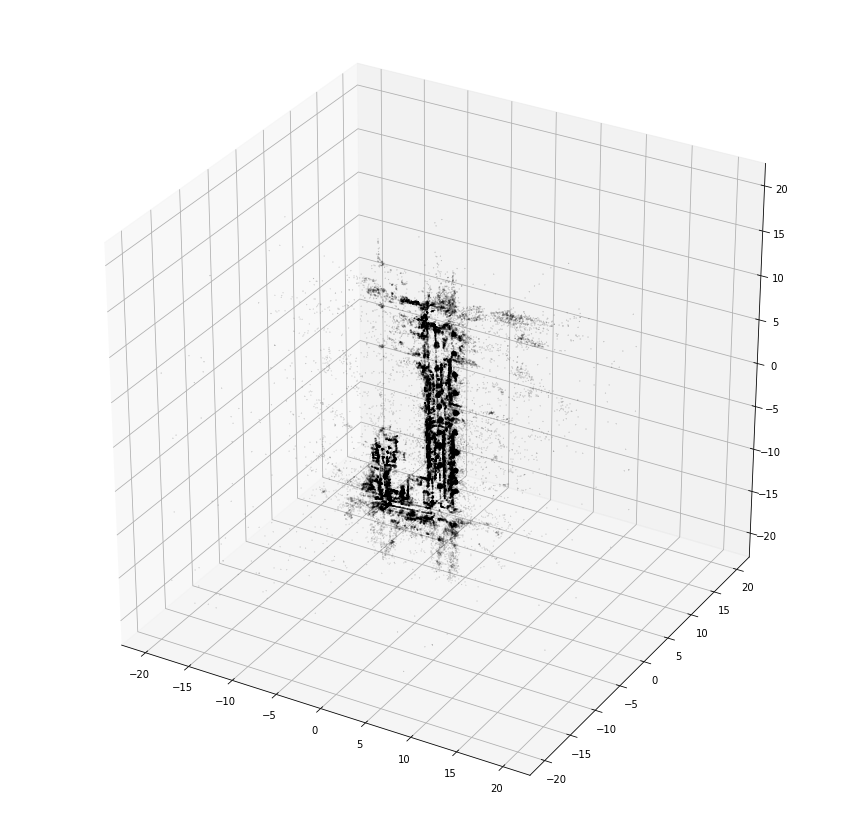

In [31]:
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
import numpy as np

fig = plt.figure(figsize=(15,15))
ax = fig.add_subplot(111, projection='3d')

c = 'black'
m = '.'
ax.scatter(points_3d[:,0], points_3d[:,1], points_3d[:,2], c=c, marker=m,s=0.05)

# ax.set_xlabel('X Label')
# ax.set_ylabel('Y Label')
# ax.set_zlabel('Z Label')

plt.show()

In [32]:
import plotly.graph_objs as go
from  plotly.offline import iplot,init_notebook_mode

def get_plot(x, y, z, c):
    init_notebook_mode(False)
    trace1 = go.Scatter3d(
        x=x,
        y=y,
        z=z,
        mode='markers',
        marker=dict(
            size=0.1,
            line=dict(
                color=c,
                width=0.5
            ),
            opacity=0.8
        )
    )
    
    layout = go.Layout(
                    scene = dict(
                    xaxis = dict(
                        nticks=4, range = [-15, 15],),
                    yaxis = dict(
                        nticks=4, range = [-15, 15],),
                    zaxis = dict(
                        nticks=4, range = [-10,10],),),
                    width=70,
                    margin=dict(
                    r=20, l=10,
                    b=10, t=10)
                  )
    fig = go.Figure(data=[trace1], layout=layout)

    return iplot(fig, filename='bla')

get_plot(points_3d[:,0], points_3d[:,1], points_3d[:,2], 'black')